In [63]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import matplotlib.image as mpimg

In [64]:
df = pd.read_csv('../Data/potholes_updated.csv')
df.head()

,Unnamed: 0.1,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,...,street_name,neighbour_hood,days_to_fix,month,year,DATE,PRCP,SNOW,TMIN,TMAX
0,0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,...,Avenue W,Gerritsen Beach,3.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
1,1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,...,East 37th Street,NaN,3.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
2,2,97384,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010002002,CSC,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,...,3rd Avenue,Manhattan Community Board 8,2.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
3,3,97390,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010003021,YRD,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,...,3rd Avenue,Manhattan Community Board 8,1.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
4,4,97391,MULTILINESTRING ((-73.95172338255492 40.773656...,DM2010003023,YRD,110010118610118630,1 AV,1 AVENUE,EAST 81 STREET,EAST 82 STREET,...,1st Avenue,Yorkville,1.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0


## Gathering Inisghts

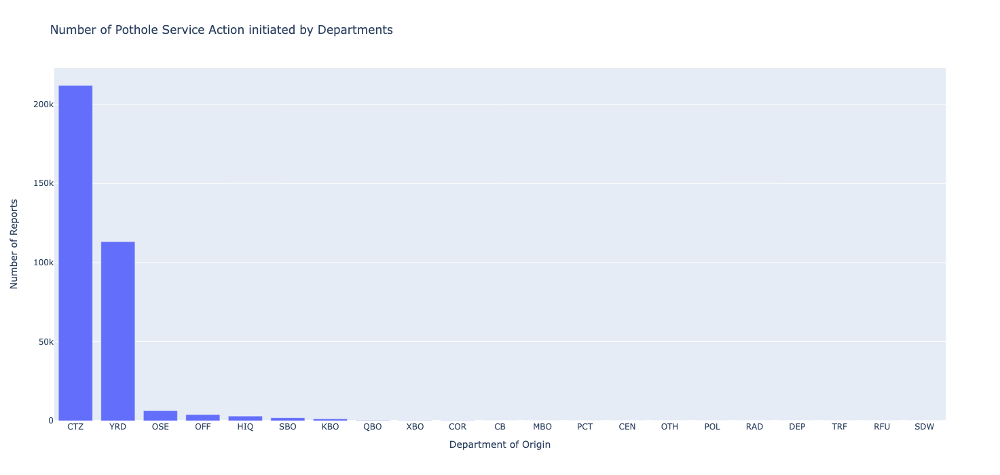

In [65]:
# Plotting the number of reports init

value_counts_Source = df['Source'].value_counts().reset_index() # storing a count of values in a variable of the "InitBy" column
value_counts_Source.columns = ['Department of Origin', 'Number of Reports'] # accessing columns of the data frame and assigning value and counts column

fig = px.bar(value_counts_Source, x='Department of Origin', y='Number of Reports', title='Number of Pothole Service Action initiated by Departments')
fig.update_layout(height=700)

# Show the plot
fig.show()

The Citizens and Yard department has contributed most, about 90% of the potholes reports. 

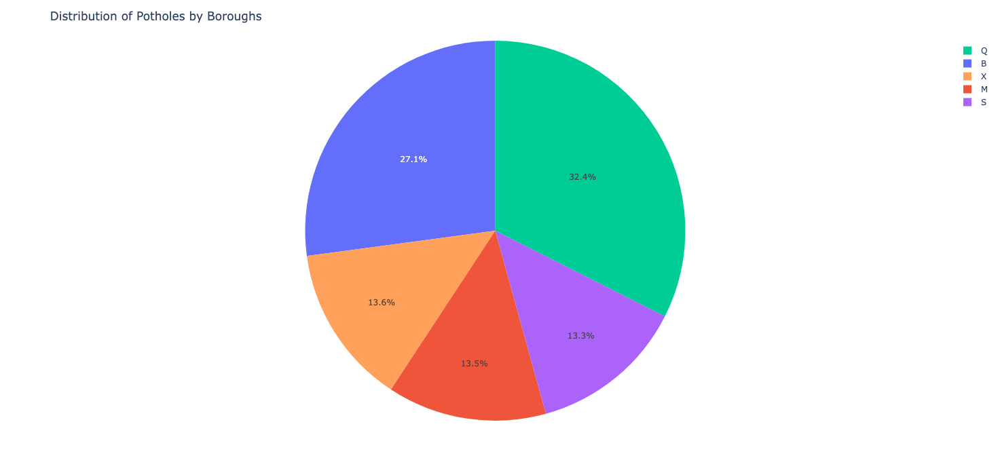

In [66]:
# Plot distribution of Number of Potholes by Boroughs of NYC

fig = px.pie(df, 
             values=df['index'].value_counts().values, 
             names='Boro', color='Boro')
fig.update_layout(title_text='Distribution of Potholes by Boroughs', height=700, width=700)

fig.show()

We can see that the most number of pothole occurrences are in Queens and then Brooklyn. We can assume that the number of potholes are dependent on the area, population, and road networks of Boroughs.

In [67]:
df['RptDate'] = df['RptDate'].astype('datetime64[ns]') # converting to pandas date_time object
df['RptClosed'] = df['RptClosed'].astype('datetime64[ns]') # converting to pandas date_time object

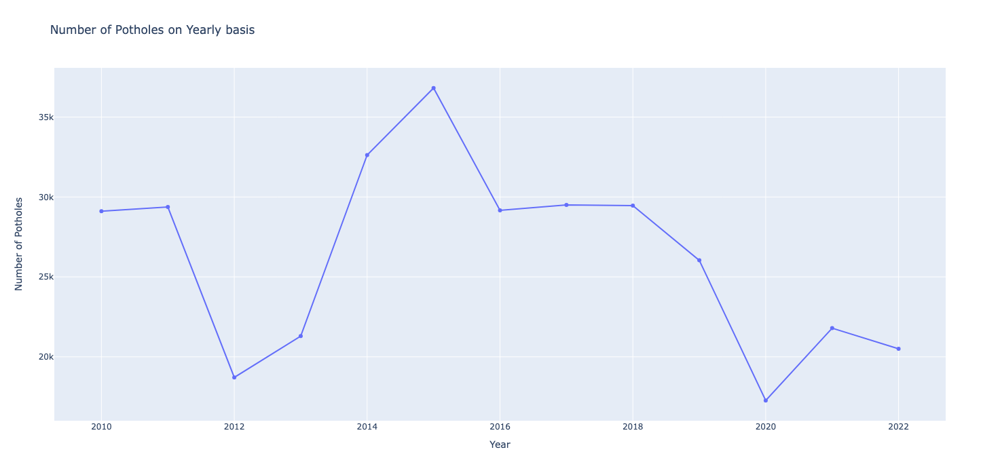

,Unnamed: 0.1,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,...,street_name,neighbour_hood,days_to_fix,month,year,DATE,PRCP,SNOW,TMIN,TMAX
0,0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,...,Avenue W,Gerritsen Beach,3.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
1,1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,...,East 37th Street,NaN,3.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
2,2,97384,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010002002,CSC,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,...,3rd Avenue,Manhattan Community Board 8,2.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
3,3,97390,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010003021,YRD,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,...,3rd Avenue,Manhattan Community Board 8,1.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0
4,4,97391,MULTILINESTRING ((-73.95172338255492 40.773656...,DM2010003023,YRD,110010118610118630,1 AV,1 AVENUE,EAST 81 STREET,EAST 82 STREET,...,1st Avenue,Yorkville,1.0,January,2010-01-02,2010-01-02,0.02,0.2,17.0,34.0


In [68]:
# Plot the number of potholes on a yearly basis
# Group by year and count potholes
df['year'] = df['year'].astype('datetime64[ns]') 
potholes_by_year = df.groupby(df['year'].dt.year).size().reset_index(name='potholes_count')

# Create a Plotly line plot
fig = px.line(potholes_by_year, x='year', y='potholes_count', markers=True, title='Number of Potholes on Yearly basis')
fig.update_layout(xaxis_title='Year', yaxis_title='Number of Potholes')
fig.update_layout(height=700)

# Show the plot
fig.show()
df.head()

In [69]:
potholes_by_year.mean()

year               2016.000000
potholes_count    26281.923077
dtype: float64

The highest number of potholes recorded in NYC in a calendar year was in 2015 with slightly over 36K potholes. Overall the yearly average is 24032 potholes per year. On average it took the relative department 4 days and a half to fix a pothole. However, there are a few outliers as well which took months to fix a pothole, probably it depends on the size of the pothole and the complexity involved.

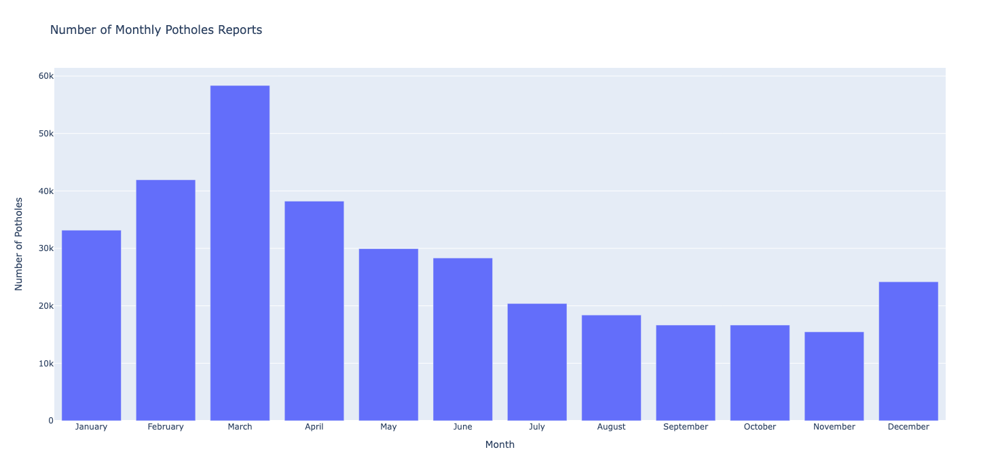

In [70]:
# months with most potholes

# Group by month and calculate the sum of potholes_count
monthly_potholes = df.groupby('month')['index'].count().reset_index()

# Create a Plotly bar chart
fig = px.bar(monthly_potholes, x='month', y='index', title='Number of Monthly Potholes Reports')

fig.update_layout(xaxis_title='Month', yaxis_title='Number of Potholes', height=700)

#plotly is not preserving monthly orders so I have to pass the parameters to adjust the monthly order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
fig.update_xaxes(categoryorder='array', categoryarray=month_order)


# Show the plot
fig.show()

The trend to note here is that the pothole numbers are maximum in the spring season which helped me to unveil an interesting fact that If the water freezes and thaws over and over, the pavement will weaken and continue cracking. 

#### Potholes Distribution by ZipCodes
The visual below is created using Tableau and hence it is stored as a png file.

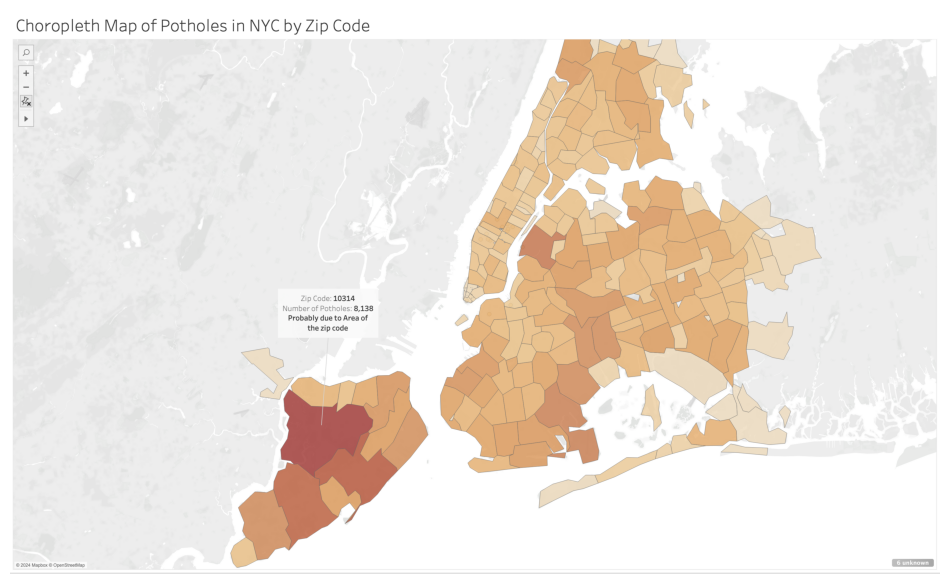

In [73]:
# Read PNG file 
img = mpimg.imread('../src/images/zipcode_choropleth.png')

# Display the image
plt.figure(figsize=(12, 10))
plt.imshow(img)
plt.axis('off')  # Turn off-axis
plt.show()

Surprisingly the zip codes with the most number of potholes are in Staten Island. Also, these zip codes are the biggest in terms of area. We can easily interpret that the number of potholes is dependent on the area of a zipcode which directly translates to a larger road network.